# Import libraries

In [1]:
from __future__ import print_function
import os
import re
import numpy as np
import  pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import time
from scipy import signal
from matplotlib.lines import Line2D
import matplotlib.lines as mlines

In [2]:
def hex_to_rgb(value):
    value = value.lstrip('#')
    return list(int(value[i:i+2], 16) for i in (0, 2, 4))

In [3]:
path_read='D:/Papers/Multitask_network/data/'
path_save='D:/Papers/Multitask_network/clean_data/'

In [4]:
#Noise filtering constant
n1 = 7
n2 = 7
m = 0.05
a = 60

In [5]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

# Load iPSC data

## Baseline

In [6]:
X_ipsc_baseline = pd.read_csv(path_read + "ipsc_baseline.csv",header=None)
X_adult_baseline = pd.read_csv(path_read + "adult_baseline.csv",header=None)
ipsc_current = pd.read_csv(path_read + "current_ipsc.csv",header=None)
adult_current = pd.read_csv(path_read + "current_adult.csv",header=None)

#Baseline
t_ipsc_baseline = X_ipsc_baseline.iloc[:, 0].values
X_ipsc_baseline = X_ipsc_baseline.iloc[:, 1].values
t_adult_baseline = X_adult_baseline.iloc[:, 0].values
X_adult_baseline = X_adult_baseline.iloc[:, 1].values


## Current

In [7]:
#ipsc current
t_ipsc=ipsc_current.iloc[:, 0].values
ipsc_vm_plot=ipsc_current.iloc[:, 1].values
ipsc_ical_plot=ipsc_current.iloc[:, 3].values
ipsc_ikr_plot=ipsc_current.iloc[:, 4].values
ipsc_iks_plot=ipsc_current.iloc[:, 5].values
ipsc_ito_plot=ipsc_current.iloc[:, 6].values
ipsc_ik1_plot=ipsc_current.iloc[:, 7].values

#adult current
t_adult=adult_current.iloc[:, 0].values
adult_vm_plot = adult_current.iloc[:, 1].values
adult_ical_plot = adult_current.iloc[:, 3].values
adult_ikr_plot = adult_current.iloc[:, 4].values
adult_iks_plot = adult_current.iloc[:, 5].values
adult_ito_plot = adult_current.iloc[:, 6].values
adult_ik1_plot = adult_current.iloc[:, 7].values

## Without noise

In [8]:
dist_ipsc_nonoise_block=pd.read_csv(path_read + "IPSC_Block_0_to_50_case_without_noise.csv",header=None)
dist_adult_nonoise_block=pd.read_csv(path_read + "Adult_Block_0_to_50_case_without_noise.csv",header=None)

dist_ipsc_nonoise_block=dist_ipsc_nonoise_block.iloc[:, 48:].values
dist_adult_nonoise_block=dist_adult_nonoise_block.iloc[:, :].values

## iPSC_control

In [9]:
columns=['AP']
Xt_control_ipsc=pd.DataFrame(columns=columns)
directory = os.listdir(path_read + "iPSC/control")
sorted(directory)
path=path_read + "iPSC/control/"
for filename in directory:
#     print(filename)
    path2=path+filename
    X1_control_ipsc = pd.read_fwf(path2, header=None)
    X13_control_ipsc = X1_control_ipsc.iloc[0:100, :].values 
    xm=pd.DataFrame({'AP': X13_control_ipsc[:,1]})
    X11_control_ipsc=X1_control_ipsc.loc[X1_control_ipsc[0]%1 == 0]
    X12_control_ipsc = X11_control_ipsc.iloc[:, :].values
    X21_control_ipsc=pd.DataFrame({'time': [0], 'AP': [-(xm['AP'].abs()).max()]})
    X22_control_ipsc=pd.DataFrame({'time': X12_control_ipsc[101:801,0], 'AP': X12_control_ipsc[101:801,1]})
    X2_control_ipsc=X21_control_ipsc.append(X22_control_ipsc, ignore_index=True, sort=False)
    X3_control_ipsc=X2_control_ipsc['AP']
    X4_control_ipsc=X3_control_ipsc.transpose()
    Xt_control_ipsc=Xt_control_ipsc.append(X4_control_ipsc, ignore_index=True, sort=False)
    
Xt_control_ipsc=Xt_control_ipsc.drop(['AP'], axis = 1)
Xt_control_ipsc.head()

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
0,-72.666836,8.340115,16.998922,22.128163,24.479066,25.708205,26.277110,26.629494,26.961468,27.741259,...,-75.512045,-75.112542,-74.810338,-75.209404,-74.958104,-75.341627,-75.627314,-75.971312,-76.583494,-76.214505
1,-74.349153,7.106526,17.811749,23.326764,26.111129,27.297479,28.109522,28.872333,29.462197,29.127675,...,-75.168764,-75.452056,-75.500463,-75.640939,-75.168895,-75.309821,-74.275181,-74.073366,-74.179755,-74.700529
2,-71.506719,-4.162667,10.251113,18.496012,22.682407,24.959843,25.567011,26.294486,26.868633,26.753702,...,-75.037515,-74.815600,-74.813011,-74.864146,-75.004552,-75.179161,-75.637737,-75.774596,-76.095294,-76.097620
3,-72.464677,0.357782,12.998604,19.501371,23.222568,25.202952,26.362074,26.800759,26.973925,26.761451,...,-74.608439,-74.675901,-74.671249,-74.772442,-75.192438,-75.117727,-75.358624,-75.085507,-75.192883,-74.748994
4,-71.659332,-4.720432,10.491325,18.775072,23.212452,25.533299,26.551534,27.222240,27.007313,27.505653,...,-77.068274,-77.124302,-77.166129,-77.107951,-77.462782,-78.001885,-77.718851,-77.741027,-77.590418,-77.886597


## iPSC_block

In [10]:
columns=['AP']
Xt_block_ipsc=pd.DataFrame(columns=columns)
directory = os.listdir(path_read + "iPSC/Block")
sorted(directory)
path=path_read + "iPSC/Block/"
for filename in directory:
#     print(filename)
    path2=path+filename
    X1_block_ipsc = pd.read_fwf(path2, header=None)
    X13_block_ipsc = X1_block_ipsc.iloc[0:100, :].values 
    xm=pd.DataFrame({'AP': X13_block_ipsc[:,1]})
    X11_block_ipsc=X1_block_ipsc.loc[X1_block_ipsc[0]%1 == 0]
    X12_block_ipsc = X11_block_ipsc.iloc[:, :].values
    X21_block_ipsc=pd.DataFrame({'time': [0], 'AP': [-(xm['AP'].abs()).max()]})
    X22_block_ipsc=pd.DataFrame({'time': X12_block_ipsc[101:801,0], 'AP': X12_block_ipsc[101:801,1]})
    X2_block_ipsc=X21_block_ipsc.append(X22_block_ipsc, ignore_index=True, sort=False)
    X3_block_ipsc=X2_block_ipsc['AP']
    X4_block_ipsc=X3_block_ipsc.transpose()
    Xt_block_ipsc=Xt_block_ipsc.append(X4_block_ipsc, ignore_index=True, sort=False)
    
Xt_block_ipsc=Xt_block_ipsc.drop(['AP'], axis = 1)
Xt_block_ipsc.head()

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
0,-73.905523,3.679156,14.960857,20.607617,23.803189,25.318691,26.318719,26.631738,26.963577,27.912584,...,-72.868192,-72.999633,-73.411238,-73.726097,-74.074055,-74.411671,-74.413129,-74.834256,-74.479149,-74.663546
1,-75.630738,3.558118,14.217081,19.790133,23.140468,24.807085,25.371344,25.536536,25.552244,25.863359,...,-72.060595,-72.208238,-72.163185,-71.864797,-71.378718,-71.193665,-71.462356,-71.624990,-71.477271,-71.213909
2,-71.098287,5.577642,14.938448,20.466948,23.740160,24.994622,25.482610,26.152929,26.416916,26.402234,...,-73.336935,-73.792246,-74.014668,-74.092442,-73.698457,-73.298533,-72.949432,-73.439864,-73.047550,-73.123000
3,-70.804175,6.623460,15.391658,20.536357,23.530994,24.811658,25.591232,26.068019,26.086528,26.051058,...,-75.246355,-74.982523,-75.179597,-74.816346,-74.352686,-73.956437,-74.021516,-73.927795,-73.808256,-74.495659
4,-73.231880,3.561663,15.725354,21.706616,24.787804,26.316448,27.257267,27.949829,28.313351,27.891521,...,-76.892188,-76.021421,-75.978812,-76.406279,-76.109393,-75.553925,-75.747076,-75.862094,-76.303804,-76.332758


## iPSC_Dof2

In [11]:
columns=['AP']
Xt_dof_ipsc=pd.DataFrame(columns=columns)
directory = os.listdir(path_read + "iPSC/dof2")
sorted(directory)
path=path_read + "iPSC/dof2/"
for filename in directory:
#     print(filename)
    path2=path+filename
    X1_dof_ipsc = pd.read_fwf(path2, header=None)
    X13_dof_ipsc = X1_dof_ipsc.iloc[0:100, :].values 
    xm=pd.DataFrame({'AP': X13_dof_ipsc[:,1]})
    X11_dof_ipsc=X1_dof_ipsc.loc[X1_dof_ipsc[0]%1 == 0]
    X12_dof_ipsc = X11_dof_ipsc.iloc[:, :].values
    X21_dof_ipsc=pd.DataFrame({'time': [0], 'AP': [-(xm['AP'].abs()).max()]})
    X22_dof_ipsc=pd.DataFrame({'time': X12_dof_ipsc[101:801,0], 'AP': X12_dof_ipsc[101:801,1]})
    X2_dof_ipsc=X21_dof_ipsc.append(X22_dof_ipsc, ignore_index=True, sort=False)
    X3_dof_ipsc=X2_dof_ipsc['AP']
    X4_dof_ipsc=X3_dof_ipsc.transpose()
    Xt_dof_ipsc=Xt_dof_ipsc.append(X4_dof_ipsc, ignore_index=True, sort=False)
    
Xt_dof_ipsc=Xt_dof_ipsc.drop(['AP'], axis = 1)
Xt_dof_ipsc.head()

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
0,-73.269117,-2.379064,11.500198,18.910325,22.789293,24.778216,25.554352,26.170179,26.077772,26.252289,...,-78.683078,-78.562005,-78.152468,-77.912616,-77.778290,-78.022505,-78.156146,-78.617437,-77.987150,-78.345155
1,-75.837819,3.937102,15.798827,22.080861,25.236531,26.818908,27.836792,28.159305,28.434741,28.254413,...,-76.841873,-77.042348,-76.801608,-76.973140,-77.273465,-77.740395,-77.894776,-78.258999,-77.803969,-77.870550
2,-73.613058,1.129684,14.311933,20.855266,24.007042,26.003220,26.907937,26.903271,27.506731,27.925387,...,-76.115319,-76.455537,-76.532322,-76.305638,-76.485914,-76.130109,-75.871146,-75.565864,-75.956214,-76.170445
3,-71.696026,4.922501,15.879427,21.234562,24.863830,26.005567,26.948585,27.743121,27.535086,27.250525,...,-76.104656,-76.652314,-76.378308,-76.082538,-76.039356,-75.761419,-75.598781,-75.139372,-75.164827,-75.109962
4,-73.925736,-2.667010,11.626942,19.460178,23.618625,26.049186,27.119881,27.205041,26.841338,27.167962,...,-76.341058,-75.971014,-75.805270,-75.610120,-75.577364,-75.826710,-75.349314,-75.337160,-75.178761,-75.079325


# Load adult data

## adult control

In [12]:
columns=['AP']
Xt_control_adult=pd.DataFrame(columns=columns)

directory = os.listdir(path_read + "adult/control")
sorted(directory)
path=path_read + "adult/control/"
for filename in directory:
#     print(filename)
    path2=path+filename
    X_control_adult = pd.read_csv(path2, sep="\t", header=None)
    X1_control_adult=X_control_adult.loc[X_control_adult[0]%1 == 0]
    X11_control_adult = X1_control_adult.iloc[:, :].values
    X2_control_adult=pd.DataFrame({'time': X11_control_adult[0:701,0], 'AP': X11_control_adult[0:701,1]})
    X3_control_adult=X2_control_adult['AP']
    X4_control_adult=X3_control_adult.transpose()
    Xt_control_adult=Xt_control_adult.append(X4_control_adult, ignore_index=True, sort=False)
    
Xt_control_adult=Xt_control_adult.drop(['AP'], axis = 1)
Xt_control_adult.head()

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
0,-87.6109,-36.7866,33.4065,37.9414,39.6717,39.9584,39.4889,39.2573,39.2371,39.1903,...,-87.9834,-88.4306,-88.4150,-88.1786,-88.1856,-88.0248,-87.8134,-88.0444,-88.5427,-88.3415
1,-88.4374,-40.1501,33.1573,37.4780,39.6669,40.3552,40.3161,40.4812,40.3459,39.8807,...,-87.1702,-87.0127,-86.6150,-86.9661,-86.5035,-87.0903,-87.0845,-87.2507,-87.1574,-86.9524
2,-87.1928,-35.6851,33.7725,38.1292,39.7912,39.7264,39.6533,39.5301,39.2740,38.9883,...,-87.5534,-87.2679,-87.1576,-87.3911,-87.8136,-88.1003,-88.0832,-87.9400,-87.8599,-88.3167
3,-87.8016,-37.5307,33.7811,37.9479,39.1384,39.5534,39.7352,40.6129,40.0023,39.8401,...,-86.8245,-87.5771,-86.9655,-87.1381,-87.1415,-87.0920,-87.4984,-87.4909,-87.5306,-87.3826
4,-88.5938,-40.9472,32.6774,37.6901,39.1614,39.7223,39.8687,40.2677,39.9990,39.5120,...,-88.2750,-88.7834,-88.5437,-88.7126,-88.5835,-88.1419,-88.2756,-88.5575,-88.7590,-89.1505


## adult block

In [13]:
columns=['AP']
Xt_block_adult=pd.DataFrame(columns=columns)

directory = os.listdir(path_read + "adult/Block")
sorted(directory)
path=path_read + "adult/Block/"
for filename in directory:
#     print(filename)
    path2=path+filename
    X_block_adult = pd.read_csv(path2, sep="\t", header=None)
    X1_block_adult=X_block_adult.loc[X_block_adult[0]%1 == 0]
    X11_block_adult = X1_block_adult.iloc[:, :].values
    X2_block_adult=pd.DataFrame({'time': X11_block_adult[0:701,0], 'AP': X11_block_adult[0:701,1]})
    X3_block_adult=X2_block_adult['AP']
    X4_block_adult=X3_block_adult.transpose()
    Xt_block_adult=Xt_block_adult.append(X4_block_adult, ignore_index=True, sort=False)
    
Xt_block_adult=Xt_block_adult.drop(['AP'], axis = 1)
Xt_block_adult.head()

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
0,-88.6613,-42.0650,32.1790,37.6062,39.1222,40.2042,40.3495,40.4000,40.2956,40.2226,...,-87.7024,-87.8876,-87.6307,-87.9083,-87.7810,-87.6587,-87.8461,-87.8359,-87.9727,-87.9116
1,-88.8960,-41.8655,31.9781,36.9658,39.0575,39.4371,39.6339,39.3270,38.9769,38.6791,...,-86.5448,-87.0599,-86.8650,-87.0754,-87.0505,-86.8421,-87.3682,-87.3554,-87.4676,-87.4458
2,-88.4959,-41.1892,32.2856,37.4360,39.3714,40.1885,39.9745,39.8462,39.6824,39.6128,...,-88.2594,-88.0166,-88.0901,-88.1144,-87.8985,-87.6408,-87.0862,-87.2703,-87.8874,-88.2848
3,-88.1830,-40.4108,32.0867,37.3056,39.2828,39.7629,39.9911,39.6022,39.5056,39.1513,...,-87.2528,-87.4301,-87.8372,-87.9659,-88.0326,-88.1005,-87.8074,-88.0374,-88.2022,-88.8651
4,-87.9802,-39.0539,32.6544,37.6279,39.1957,39.7898,39.6827,39.5049,39.0808,38.6727,...,-87.4615,-87.9568,-87.6311,-87.1812,-87.7488,-87.8377,-87.6140,-87.4337,-88.2286,-87.7665


## adult Dof2

In [14]:
columns=['AP']
Xt_dof_adult=pd.DataFrame(columns=columns)

directory = os.listdir(path_read + "adult/Dof2")
sorted(directory)
path=path_read + "adult/DOf2/"
for filename in directory:
#     print(filename)
    path2=path+filename
    X_dof_adult = pd.read_csv(path2, sep="\t", header=None)
    X1_dof_adult=X_dof_adult.loc[X_dof_adult[0]%1 == 0]
    X11_dof_adult = X1_dof_adult.iloc[:, :].values
    X2_dof_adult=pd.DataFrame({'time': X11_dof_adult[0:701,0], 'AP': X11_dof_adult[0:701,1]})
    X3_dof_adult=X2_dof_adult['AP']
    X4_dof_adult=X3_dof_adult.transpose()
    Xt_dof_adult=Xt_dof_adult.append(X4_dof_adult, ignore_index=True, sort=False)
    
Xt_dof_adult=Xt_dof_adult.drop(['AP'], axis = 1)
Xt_dof_adult.head()

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
0,-88.4280,-39.0995,33.3603,37.7050,39.1742,39.6911,39.6865,39.9179,40.4758,40.0974,...,-87.8189,-87.6398,-87.3221,-87.5030,-87.6299,-87.7331,-87.2685,-87.8424,-87.8630,-88.0480
1,-87.8862,-38.6202,33.9990,38.8336,40.4479,40.6480,41.3702,41.2629,41.4234,41.3720,...,-87.5190,-87.7062,-87.8289,-87.7543,-87.7212,-87.8313,-87.8918,-87.8856,-87.8571,-87.6407
2,-87.9210,-38.3252,33.9741,39.0441,40.5773,41.4086,40.9444,41.2842,41.6680,41.5601,...,-87.3855,-87.3031,-87.0680,-87.4521,-87.4151,-87.7030,-87.9827,-87.9408,-88.3103,-88.0199
3,-87.7946,-38.1424,33.0317,38.0829,39.9708,40.6197,40.9888,41.6882,41.2382,41.0333,...,-87.9895,-88.3110,-88.1175,-88.1428,-88.1517,-88.3290,-88.6593,-88.6536,-88.6537,-88.8140
4,-86.9861,-33.3730,33.9227,38.7636,40.1630,40.8445,41.3743,41.3292,41.1402,41.3392,...,-88.0330,-88.0748,-87.9102,-87.8796,-87.9909,-87.5994,-88.3609,-88.5841,-87.9788,-88.0685


In [15]:
Xt_dof_adult.tail(10)

,0,1,2,3,4,5,6,7,8,9,...,691,692,693,694,695,696,697,698,699,700
291,-87.5575,-36.7702,33.5988,38.4982,40.1499,40.9861,41.3567,41.2436,41.4518,41.5694,...,-88.1465,-88.2841,-88.1169,-88.0598,-87.8836,-87.7451,-87.6391,-88.2566,-88.5655,-88.5822
292,-88.9376,-41.2126,33.2071,38.5309,40.1049,41.5383,41.4471,41.1625,40.7520,40.6383,...,-87.0036,-86.8200,-86.8551,-87.5173,-87.9507,-87.9223,-87.8418,-88.0371,-87.9216,-87.8182
293,-87.4260,-31.8393,34.4833,38.6434,40.1776,40.5058,40.7147,40.7924,40.5616,40.1371,...,-87.7330,-88.0096,-87.6069,-86.9817,-86.4971,-86.5472,-86.6772,-86.5402,-86.8543,-87.0820
294,-88.9376,-41.2125,33.2075,38.5314,40.1054,41.5388,41.4478,41.1634,40.7530,40.6395,...,-87.0035,-86.8199,-86.8550,-87.5172,-87.9506,-87.9223,-87.8418,-88.0371,-87.9215,-87.8182
295,-88.6941,-39.3610,33.9952,38.8498,40.3254,40.9715,41.0531,40.7540,40.6633,40.5452,...,-86.3873,-86.3818,-86.9231,-87.4488,-87.8030,-87.4636,-87.7639,-87.8376,-87.6962,-87.5959
296,-88.2231,-39.2072,33.9949,38.9014,40.7848,41.2257,41.2252,41.3861,41.6151,41.3665,...,-87.3422,-87.5473,-87.4873,-87.5162,-87.6518,-87.8234,-88.4696,-88.2987,-88.4338,-88.0138
297,-87.0993,-36.2411,33.8897,38.7836,40.7660,41.2283,41.4148,41.4075,41.1101,41.1136,...,-87.0823,-87.3429,-87.5234,-87.3496,-87.4328,-87.1215,-87.3650,-87.9366,-88.0661,-87.9956
298,-87.8188,-38.0868,33.3221,38.1373,40.3202,41.0347,41.4348,41.1106,40.6675,40.3747,...,-88.2317,-88.0975,-88.3305,-88.3762,-88.4081,-88.5019,-88.4786,-88.3229,-87.8429,-88.3425
299,-87.1330,-34.8008,33.9494,38.1660,40.4616,41.1673,41.3836,41.4588,41.2204,40.6067,...,-87.8009,-87.7412,-87.2102,-87.0463,-87.0019,-87.0704,-87.5158,-87.5838,-87.5392,-87.8907
300,-88.4000,-39.9854,33.0910,37.8928,39.9741,40.6448,41.6936,41.6188,41.4521,41.2547,...,-87.7342,-87.8026,-87.2555,-87.4293,-87.1934,-87.0491,-86.7843,-87.1526,-87.5368,-87.3928


# Plots

## Currents

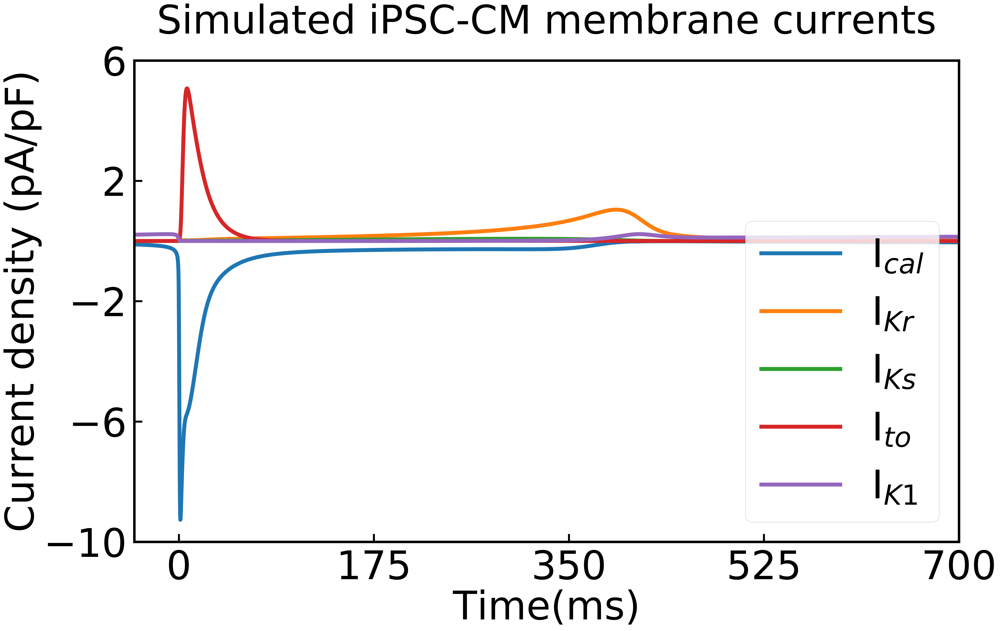

In [64]:
#iPSC
a = 80
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
plt.ylim(-10, 6) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-10,6.1, step=4),fontsize=a)
plt.plot(t_ipsc,ipsc_ical_plot,linewidth=8,label='I$_{cal}$')
plt.plot(t_ipsc,ipsc_ikr_plot,linewidth=8,label='I$_{Kr}$')
plt.plot(t_ipsc,ipsc_iks_plot,linewidth=8,label='I$_{Ks}$')
plt.plot(t_ipsc,ipsc_ito_plot,linewidth=8,label='I$_{to}$')
plt.plot(t_ipsc,ipsc_ik1_plot,linewidth=8,label='I$_{K1}$')
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Current density (pA/pF)",fontsize=a)
plt.legend(loc='lower right', prop={'size': a})
ttl = plt.title("Simulated iPSC-CM membrane currents",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/iPSC_current.png', dpi = 300, bbox_inches = 'tight')

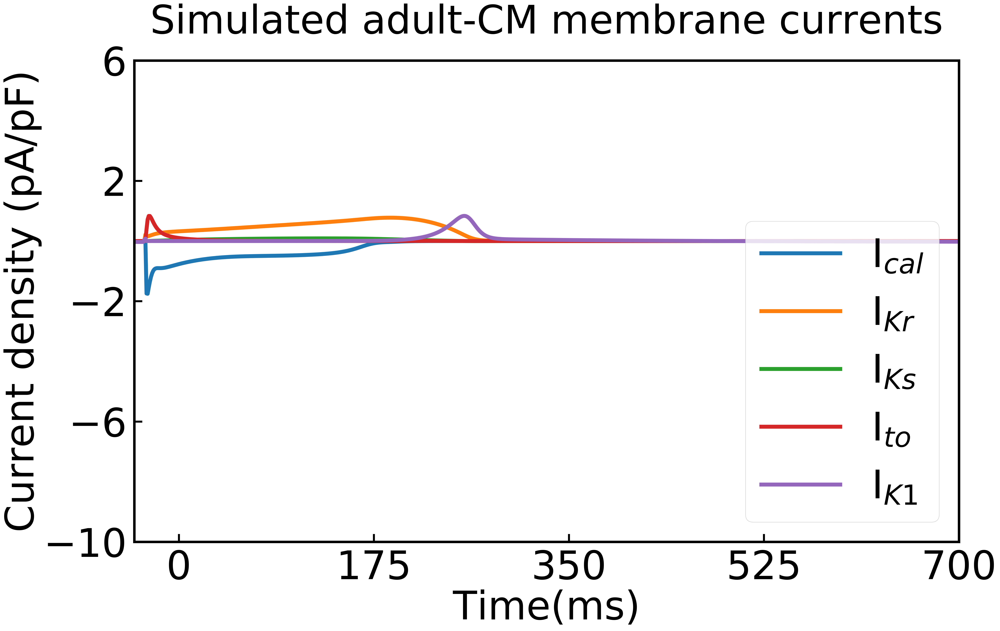

In [63]:
#adult
#iPSC
a = 80
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
plt.ylim(-10, 6) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-10,6.1, step=4),fontsize=a)
plt.plot(t_adult,adult_ical_plot,linewidth=8,label='I$_{cal}$')
plt.plot(t_adult,adult_ikr_plot,linewidth=8,label='I$_{Kr}$')
plt.plot(t_adult,adult_iks_plot,linewidth=8,label='I$_{Ks}$')
plt.plot(t_adult,adult_ito_plot,linewidth=8,label='I$_{to}$')
plt.plot(t_adult,adult_ik1_plot,linewidth=8,label='I$_{K1}$')
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Current density (pA/pF)",fontsize=a)
plt.legend(loc='lower right', prop={'size': a})
ttl = plt.title("Simulated adult-CM membrane currents",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/adult_current.png', dpi = 300, bbox_inches = 'tight')

## Baseline

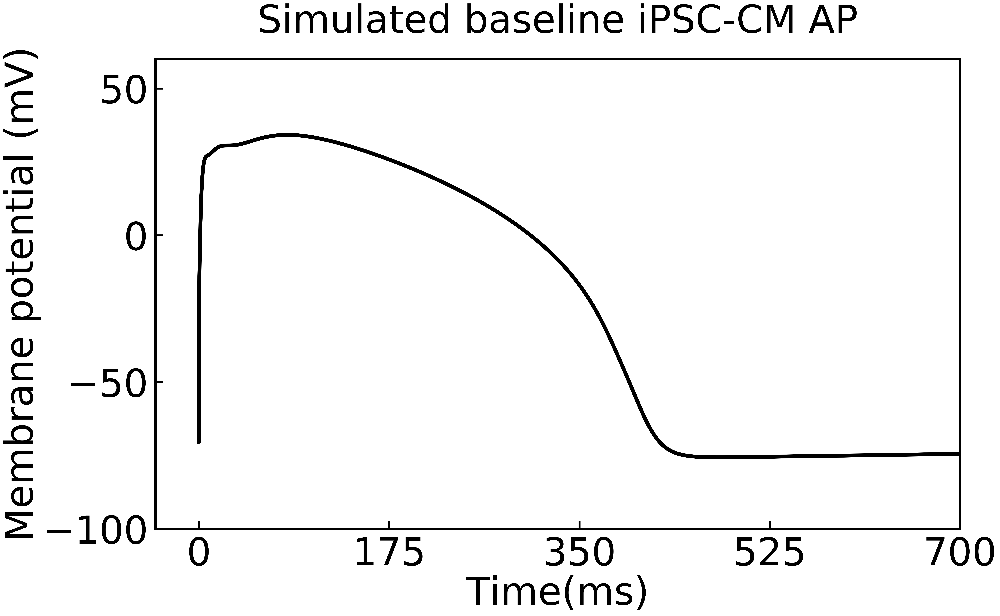

In [18]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(t_ipsc_baseline , X_ipsc_baseline.transpose(),linewidth=8,color=[0,0,0])
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated baseline iPSC-CM AP",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig11.png', dpi = 300, bbox_inches = 'tight')

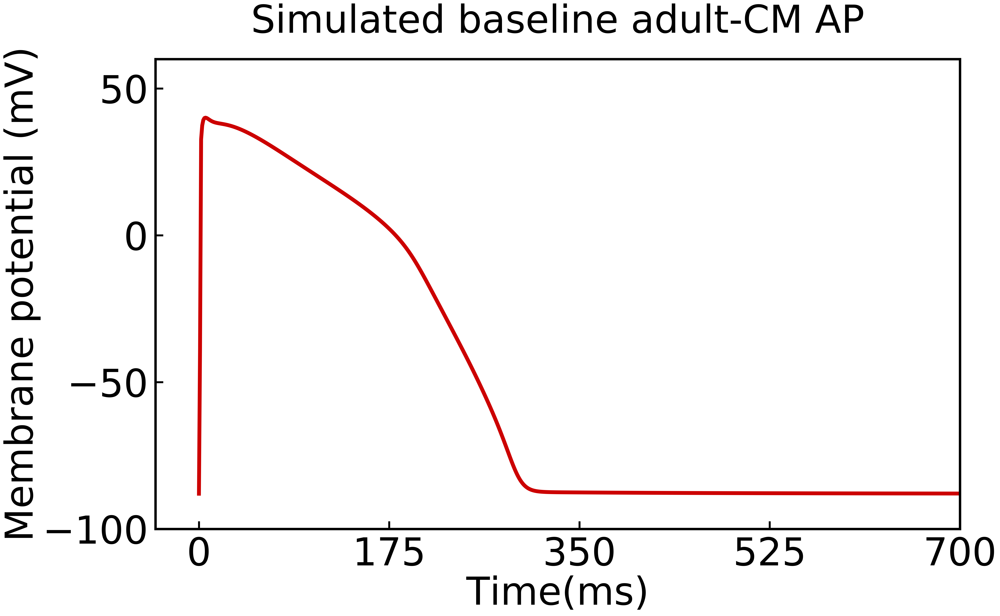

In [19]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(t_adult_baseline, X_adult_baseline.transpose(),linewidth=8,color=[0.8,0,0])
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated baseline adult-CM AP",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig12.png', dpi = 300, bbox_inches = 'tight')

## iPSC control plot

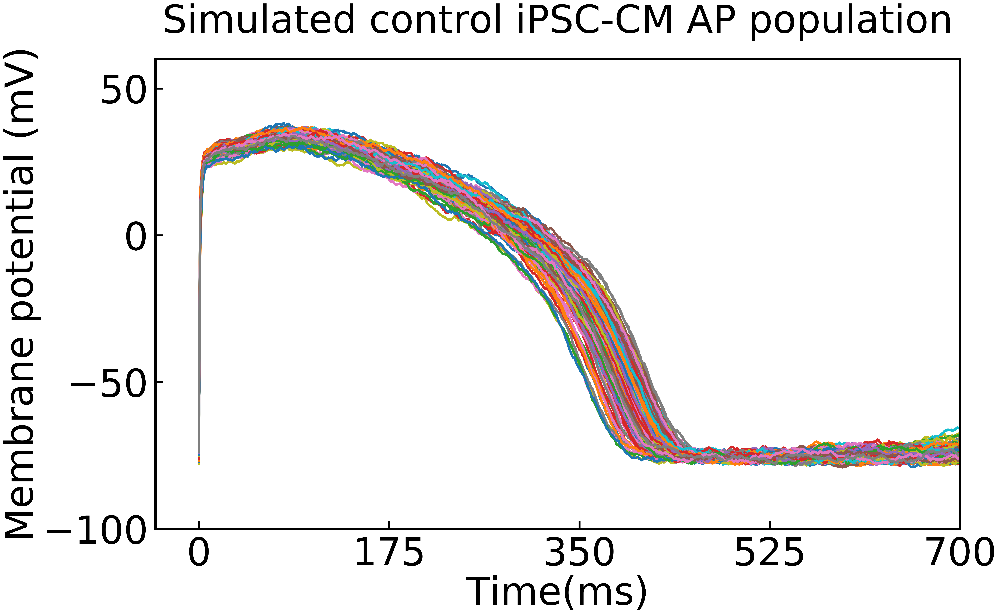

In [20]:
Xplot_control_ipsc1=Xt_control_ipsc.iloc[:, :].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(Xplot_control_ipsc1.transpose(), linewidth=5)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated control iPSC-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig21.png', dpi = 300, bbox_inches = 'tight')

## iPSC block plot

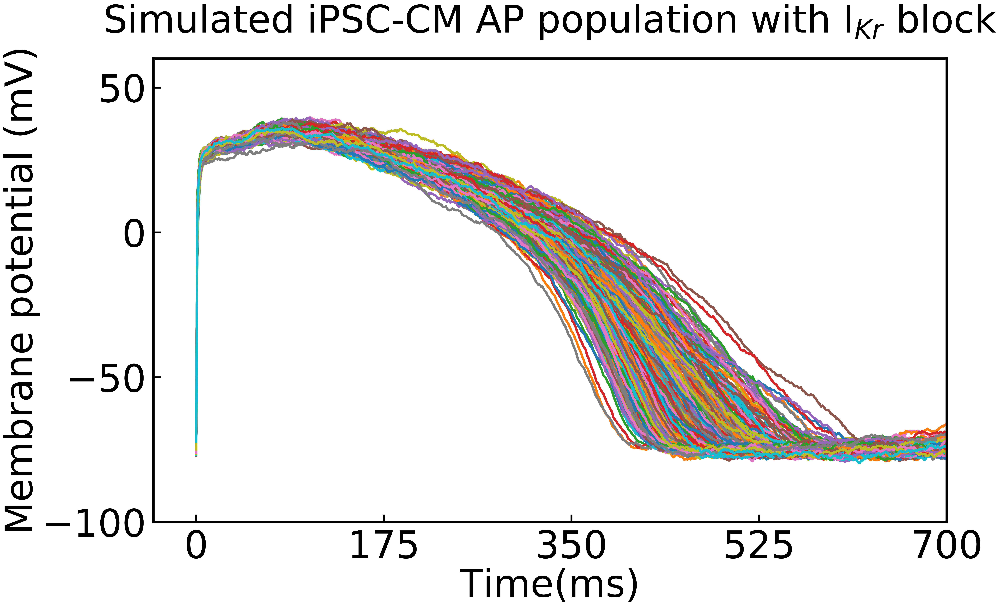

In [21]:
Xplot_block_ipsc1=Xt_block_ipsc.iloc[:, :].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
# plt.plot(Xplot_control_ipsc1.transpose(), 'k',linewidth=3)
plt.plot(Xplot_block_ipsc1.transpose(), linewidth=5)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated iPSC-CM AP population with I$_{Kr}$ block",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig31.png', dpi = 300, bbox_inches = 'tight')

## iPSC dofetilide plot

In [22]:
Xplot_dof_ipsc1=Xt_dof_ipsc.iloc[:, :].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
# plt.plot(Xplot_control_ipsc1.transpose(), 'k',linewidth=3)
plt.plot(Xplot_dof_ipsc1.transpose(), linewidth=5)

for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated iPSC-CM AP population with dofetilide (2.2 nM)",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig41.png', dpi = 300, bbox_inches = 'tight')

## iPSC all together plot

In [23]:

col=np.array(hex_to_rgb('#9B0065'))
col/255

array([0.60784314, 0.        , 0.39607843])

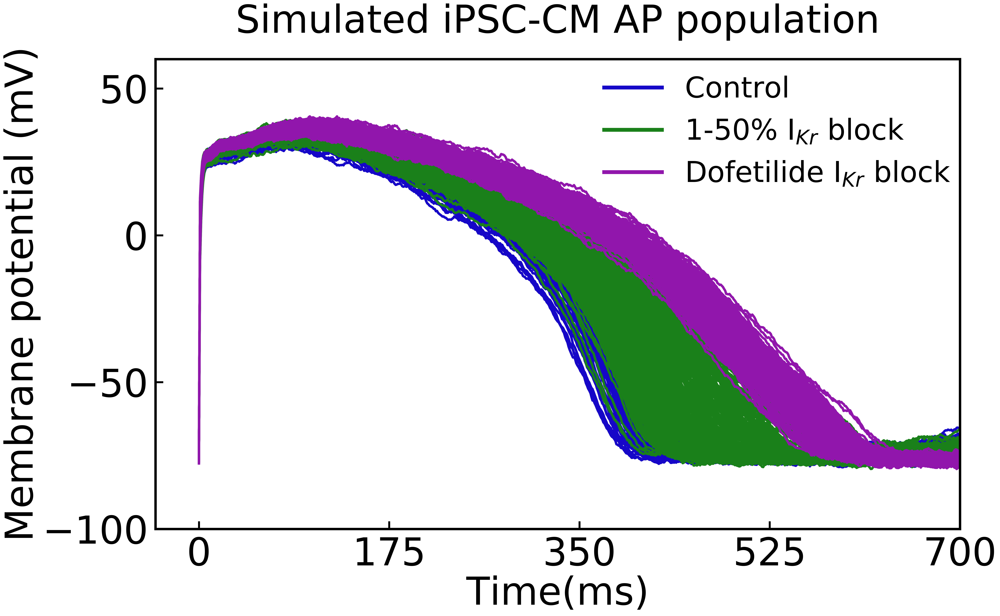

In [24]:
a=80
Xplot_dof_ipsc1=Xt_dof_ipsc.iloc[:, :].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
# plt.plot(Xplot_control_ipsc1.transpose(), 'k',linewidth=3)
plt.plot(Xplot_control_ipsc1.transpose(),color=[22/256,6/256,201/256], linewidth=5)
plt.plot(Xplot_block_ipsc1.transpose(), color=[0.1,0.5,0.1], linewidth=5)
plt.plot(Xplot_dof_ipsc1.transpose(), color=[146/256,23/256,173/256], linewidth=5)
custom_lines = [            
Line2D([0], [0], color=[22/256,6/256,201/256], lw=8),
Line2D([0], [0], color=[0.1,0.5,0.1], lw=8),
Line2D([0], [0], color=[146/256,23/256,173/256], lw=8)]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated iPSC-CM AP population",fontsize=a)
ax.legend(custom_lines, ['Control', '1-50% I$_{Kr}$ block','Dofetilide I$_{Kr}$ block'],loc = 'upper right', bbox_to_anchor=(1.02, 1.02),fontsize=60, frameon=False)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig51.png', dpi = 300, bbox_inches = 'tight')

## adult control plot

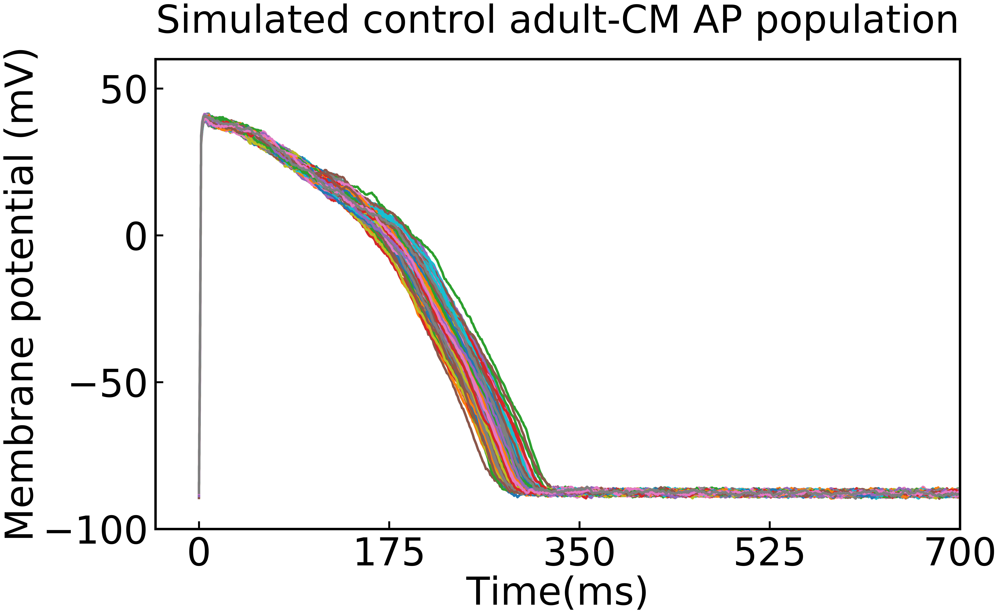

In [25]:
Xplot_control_adult1=Xt_control_adult.iloc[:, :].values
plt.figure(num=None, figsize=(30,18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(Xplot_control_adult1.transpose(), linewidth=5)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated control adult-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig22.png', dpi = 300, bbox_inches = 'tight')

## adult block plot

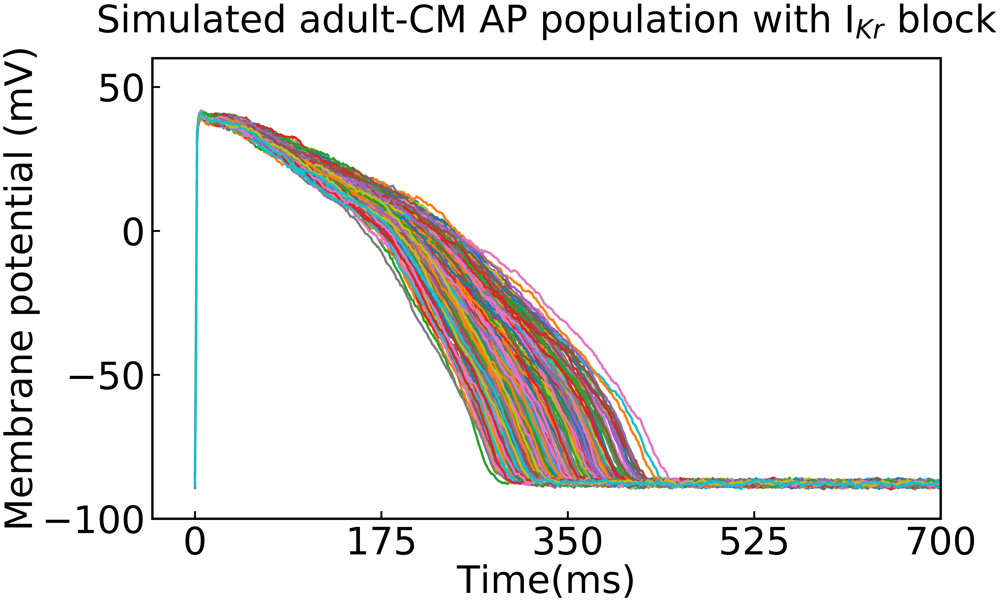

In [26]:
Xplot_block_adult1=Xt_block_adult.iloc[:, :].values
plt.figure(num=None, figsize=(30,18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(Xplot_block_adult1.transpose(), linewidth=5)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated adult-CM AP population with I$_{Kr}$ block",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig32.png', dpi = 300, bbox_inches = 'tight')

## adult dofetilide plot

In [27]:
Xplot_dof_adult1=Xt_dof_adult.iloc[:, :].values
plt.figure(num=None, figsize=(30,18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(Xplot_dof_adult1.transpose(), linewidth=5)
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated adult-CM AP population with dofetilide (2.2 nM)",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig42.png', dpi = 300, bbox_inches = 'tight')

## adult all together plot

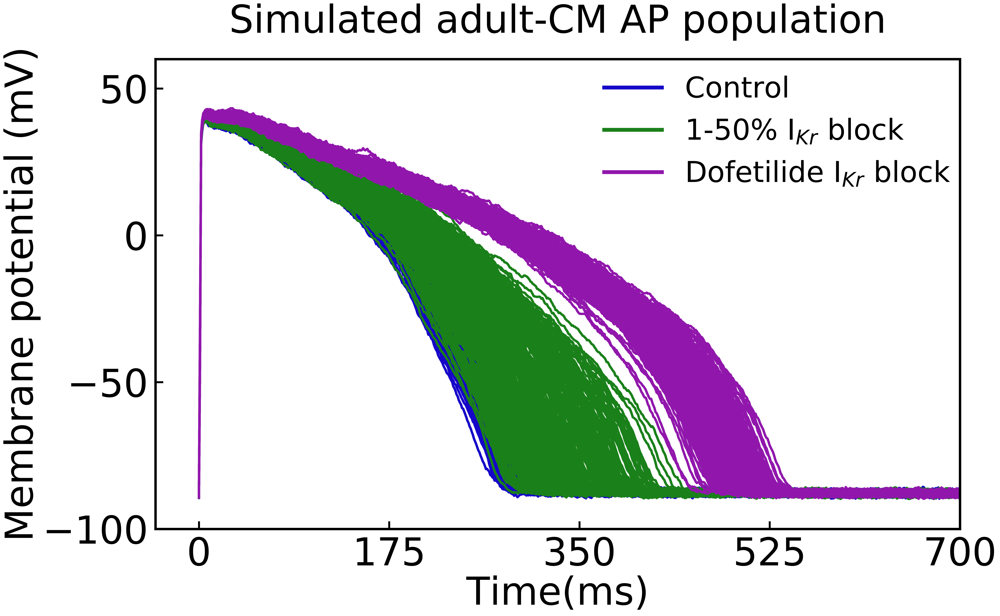

In [28]:

plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
# ax.spines["top"].set_visible(False)  
# ax.spines["right"].set_visible(False)  
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
# plt.plot(Xplot_control_ipsc1.transpose(), 'k',linewidth=3)
plt.plot(Xplot_control_adult1.transpose(),color=[22/256,6/256,201/256], linewidth=5)
plt.plot(Xplot_block_adult1.transpose(), color=[0.1,0.5,0.1], linewidth=5)
plt.plot(Xplot_dof_adult1.transpose(), color=[146/256,23/256,173/256], linewidth=5)
custom_lines = [            
Line2D([0], [0], color=[22/256,6/256,201/256], lw=8),
Line2D([0], [0], color=[0.1,0.5,0.1], lw=8),
Line2D([0], [0], color=[146/256,23/256,173/256], lw=8)]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("Simulated adult-CM AP population",fontsize=a)
ax.legend(custom_lines, ['Control', '1-50% I$_{Kr}$ block','Dofetilide I$_{Kr}$ block'],loc = 'upper right', bbox_to_anchor=(1.02, 1.02),fontsize=60, frameon=False)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig1/Fig52.png', dpi = 300, bbox_inches = 'tight')

# Filter noise

## iPSC without block

In [29]:
Xplot_control_ipsc2=pd.DataFrame()
for i in range(Xt_control_ipsc.shape[0]):
    Xplot_control_ipsc21=Xt_control_ipsc.iloc[i, :n1].values
    Xplot_control_ipsc22=Xt_control_ipsc.iloc[i, n1:].values

    b, a = signal.butter(1, m)
    Xplot_control_ipsc22=signal.filtfilt(b,a,Xplot_control_ipsc22,padlen=10)
    Xplot_control_ipsc23=np.append(Xplot_control_ipsc21,Xplot_control_ipsc22)
    Xplot_control_ipsc24 = pd.DataFrame(Xplot_control_ipsc23)
    Xplot_control_ipsc24 = Xplot_control_ipsc24.transpose()
    Xplot_control_ipsc2 = Xplot_control_ipsc2.append(Xplot_control_ipsc24, ignore_index=True, sort=False)
    
Xplot_control_ipsc2 = Xplot_control_ipsc2.iloc[:, :].values

In [30]:
APD_control_ipsc=Xt_control_ipsc.iloc[:, :].values

In [31]:
APD_control_ipsc=Xt_control_ipsc.iloc[:, :].values
APD90_control_iPSC_with_noise=[]
for i in range(len(APD_control_ipsc)):
    mai = APD_control_ipsc[i,7]
    mii = APD_control_ipsc[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(APD_control_ipsc[i], l)
    p=np.where(APD_control_ipsc[i]==t)
    APD90_control_iPSC_with_noise.append(p[0])
    
APD90_control_iPSC_with_noise=pd.DataFrame(APD90_control_iPSC_with_noise) 

APD90_control_iPSC_without_noise=[]
for i in range(len(Xplot_control_ipsc2)):
    mai = Xplot_control_ipsc2[i,7]
    mii = Xplot_control_ipsc2[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(Xplot_control_ipsc2[i], l)
    p=np.where(Xplot_control_ipsc2[i]==t)
    APD90_control_iPSC_without_noise.append(p[0])
    
APD90_control_iPSC_without_noise=pd.DataFrame(APD90_control_iPSC_without_noise) 

## iPSC with block

In [32]:
Xplot_block_ipsc2=pd.DataFrame()
for i in range(Xt_block_ipsc.shape[0]):
    Xplot_block_ipsc21=Xt_block_ipsc.iloc[i, :n1].values
    Xplot_block_ipsc22=Xt_block_ipsc.iloc[i, n1:].values

    b, a = signal.butter(1, m)
    Xplot_block_ipsc22=signal.filtfilt(b,a,Xplot_block_ipsc22,padlen=10)
    Xplot_block_ipsc23=np.append(Xplot_block_ipsc21,Xplot_block_ipsc22)
    Xplot_block_ipsc24 = pd.DataFrame(Xplot_block_ipsc23)
    Xplot_block_ipsc24 = Xplot_block_ipsc24.transpose()
    Xplot_block_ipsc2 = Xplot_block_ipsc2.append(Xplot_block_ipsc24, ignore_index=True, sort=False)
    
Xplot_block_ipsc2 = Xplot_block_ipsc2.iloc[:, :].values

In [33]:
APD_block_ipsc=Xt_block_ipsc.iloc[:, :].values
APD90_block_ipsc_with_noise=[]
for i in range(len(APD_block_ipsc)):
    mai = APD_block_ipsc[i,7]
    mii = APD_block_ipsc[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(APD_block_ipsc[i], l)
    p=np.where(APD_block_ipsc[i]==t)
    APD90_block_ipsc_with_noise.append(p[0])
    
APD90_block_ipsc_with_noise=pd.DataFrame(APD90_block_ipsc_with_noise) 

APD90_block_ipsc_without_noise=[]
for i in range(len(Xplot_block_ipsc2)):
    mai = Xplot_block_ipsc2[i,7]
    mii = Xplot_block_ipsc2[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(Xplot_block_ipsc2[i], l)
    p=np.where(Xplot_block_ipsc2[i]==t)
    APD90_block_ipsc_without_noise.append(p[0])
    
APD90_block_ipsc_without_noise=pd.DataFrame(APD90_block_ipsc_without_noise) 

APD90_block_ipsc_no_noise=[]
for i in range(len(dist_ipsc_nonoise_block)):
    mai = dist_ipsc_nonoise_block[i,7]
    mii = dist_ipsc_nonoise_block[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(dist_ipsc_nonoise_block[i], l)
    p=np.where(dist_ipsc_nonoise_block[i]==t)
    APD90_block_ipsc_no_noise.append(p[0])
    
APD90_block_ipsc_no_noise=pd.DataFrame(APD90_block_ipsc_no_noise) 

## iPSC with dofetilide

In [34]:
Xplot_dof_ipsc2=pd.DataFrame()
for i in range(Xt_dof_ipsc.shape[0]):
    Xplot_dof_ipsc21=Xt_dof_ipsc.iloc[i, :n1].values
    Xplot_dof_ipsc22=Xt_dof_ipsc.iloc[i, n1:].values

    b, a = signal.butter(1, m)
    Xplot_dof_ipsc22=signal.filtfilt(b,a,Xplot_dof_ipsc22,padlen=10)
    Xplot_dof_ipsc23=np.append(Xplot_dof_ipsc21,Xplot_dof_ipsc22)
    Xplot_dof_ipsc24 = pd.DataFrame(Xplot_dof_ipsc23)
    Xplot_dof_ipsc24 = Xplot_dof_ipsc24.transpose()
    Xplot_dof_ipsc2 = Xplot_dof_ipsc2.append(Xplot_dof_ipsc24, ignore_index=True, sort=False)
    
Xplot_dof_ipsc2 = Xplot_dof_ipsc2.iloc[:, :].values

In [35]:
APD_dof_ipsc=Xt_dof_ipsc.iloc[:, :].values
APD90_dof_ipsc_with_noise=[]
for i in range(len(APD_dof_ipsc)):
    mai = APD_dof_ipsc[i,7]
    mii = APD_dof_ipsc[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(APD_dof_ipsc[i], l)
    p=np.where(APD_dof_ipsc[i]==t)
    APD90_dof_ipsc_with_noise.append(p[0])
    
APD90_dof_ipsc_with_noise=pd.DataFrame(APD90_dof_ipsc_with_noise) 

APD90_dof_ipsc_without_noise=[]
for i in range(len(Xplot_dof_ipsc2)):
    mai = Xplot_dof_ipsc2[i,7]
    mii = Xplot_dof_ipsc2[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(Xplot_dof_ipsc2[i], l)
    p=np.where(Xplot_dof_ipsc2[i]==t)
    APD90_dof_ipsc_without_noise.append(p[0])
    
APD90_dof_ipsc_without_noise=pd.DataFrame(APD90_dof_ipsc_without_noise) 

## adult without block

In [36]:
Xplot_control_adult2=pd.DataFrame()
for i in range(Xt_control_adult.shape[0]):
    Xplot_control_adult21=Xt_control_adult.iloc[i, :n2].values
    Xplot_control_adult22=Xt_control_adult.iloc[i, n2:].values

    b, a = signal.butter(1, m)
    Xplot_control_adult22=signal.filtfilt(b,a,Xplot_control_adult22,padlen=10)
    Xplot_control_adult23=np.append(Xplot_control_adult21,Xplot_control_adult22)
    Xplot_control_adult24 = pd.DataFrame(Xplot_control_adult23)
    Xplot_control_adult24 = Xplot_control_adult24.transpose()
    Xplot_control_adult2 = Xplot_control_adult2.append(Xplot_control_adult24, ignore_index=True, sort=False)
    
Xplot_control_adult2 = Xplot_control_adult2.iloc[:, :].values

In [37]:
APD_control_adult=Xt_control_adult.iloc[:, :].values
APD90_control_adult_with_noise=[]
for i in range(len(APD_control_adult)):
    mai = APD_control_adult[i,7]
    mii = APD_control_adult[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(APD_control_adult[i], l)
    p=np.where(APD_control_adult[i]==t)
    APD90_control_adult_with_noise.append(p[0])
    
APD90_control_adult_with_noise=pd.DataFrame(APD90_control_adult_with_noise) 

APD90_control_adult_without_noise=[]
for i in range(len(Xplot_control_adult2)):
    mai = Xplot_control_adult2[i,7]
    mii = Xplot_control_adult2[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(Xplot_control_adult2[i], l)
    p=np.where(Xplot_control_adult2[i]==t)
    APD90_control_adult_without_noise.append(p[0])
    
APD90_control_adult_without_noise=pd.DataFrame(APD90_control_adult_without_noise) 

## adult with block

In [38]:
Xplot_block_adult2=pd.DataFrame()
for i in range(Xt_block_adult.shape[0]):
    Xplot_block_adult21=Xt_block_adult.iloc[i, :n2].values
    Xplot_block_adult22=Xt_block_adult.iloc[i, n2:].values

    b, a = signal.butter(1, m)
    Xplot_block_adult22=signal.filtfilt(b,a,Xplot_block_adult22,padlen=10)
    Xplot_block_adult23=np.append(Xplot_block_adult21,Xplot_block_adult22)
    Xplot_block_adult24 = pd.DataFrame(Xplot_block_adult23)
    Xplot_block_adult24 = Xplot_block_adult24.transpose()
    Xplot_block_adult2 = Xplot_block_adult2.append(Xplot_block_adult24, ignore_index=True, sort=False)
    
Xplot_block_adult2 = Xplot_block_adult2.iloc[:, :].values


In [39]:
APD_block_adult=Xt_block_adult.iloc[:, :].values
APD90_block_adult_with_noise=[]
for i in range(len(APD_block_adult)):
    mai = APD_block_adult[i,7]
    mii = APD_block_adult[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(APD_block_adult[i], l)
    p=np.where(APD_block_adult[i]==t)
    APD90_block_adult_with_noise.append(p[0])
    
APD90_block_adult_with_noise=pd.DataFrame(APD90_block_adult_with_noise) 

APD90_block_adult_without_noise=[]
for i in range(len(Xplot_block_adult2)):
    mai = Xplot_block_adult2[i,7]
    mii = Xplot_block_adult2[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(Xplot_block_adult2[i], l)
    p=np.where(Xplot_block_adult2[i]==t)
    APD90_block_adult_without_noise.append(p[0])
    
APD90_block_adult_without_noise=pd.DataFrame(APD90_block_adult_without_noise) 

APD90_block_adult_no_noise=[]
for i in range(len(dist_adult_nonoise_block)):
    mai = dist_adult_nonoise_block[i,7]
    mii = dist_adult_nonoise_block[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(dist_adult_nonoise_block[i], l)
    p=np.where(dist_adult_nonoise_block[i]==t)
    APD90_block_adult_no_noise.append(p[0])
    
APD90_block_adult_no_noise=pd.DataFrame(APD90_block_adult_no_noise) 

## adult with dofetilide

In [40]:
Xplot_dof_adult2=pd.DataFrame()
for i in range(Xt_dof_adult.shape[0]):
    Xplot_dof_adult21=Xt_dof_adult.iloc[i, :n2].values
    Xplot_dof_adult22=Xt_dof_adult.iloc[i, n2:].values

    b, a = signal.butter(1, m)
    Xplot_dof_adult22=signal.filtfilt(b,a,Xplot_dof_adult22,padlen=10)
    Xplot_dof_adult23=np.append(Xplot_dof_adult21,Xplot_dof_adult22)
    Xplot_dof_adult24 = pd.DataFrame(Xplot_dof_adult23)
    Xplot_dof_adult24 = Xplot_dof_adult24.transpose()
    Xplot_dof_adult2 = Xplot_dof_adult2.append(Xplot_dof_adult24, ignore_index=True, sort=False)
    
Xplot_dof_adult2 = Xplot_dof_adult2.iloc[:, :].values


In [41]:
APD_dof_adult=Xt_dof_adult.iloc[:, :].values
APD90_dof_adult_with_noise=[]
for i in range(len(APD_dof_adult)):
    mai = APD_dof_adult[i,7]
    mii = APD_dof_adult[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(APD_dof_adult[i], l)
    p=np.where(APD_dof_adult[i]==t)
    APD90_dof_adult_with_noise.append(p[0])
    
APD90_dof_adult_with_noise=pd.DataFrame(APD90_dof_adult_with_noise) 

APD90_dof_adult_without_noise=[]
for i in range(len(Xplot_dof_adult2)):
    mai = Xplot_dof_adult2[i,7]
    mii = Xplot_dof_adult2[i,700]
    l=mai-(0.9*(mai-mii))
    t=find_nearest(Xplot_dof_adult2[i], l)
    p=np.where(Xplot_dof_adult2[i]==t)
    APD90_dof_adult_without_noise.append(p[0])
    
APD90_dof_adult_without_noise=pd.DataFrame(APD90_dof_adult_without_noise) 

# Filtered noise data plots

## iPSC control

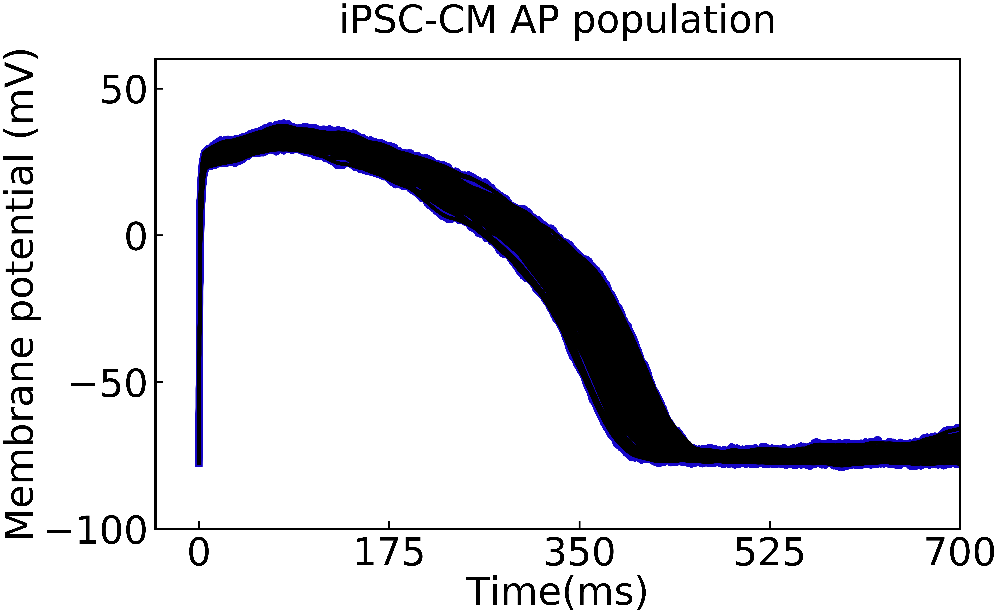

In [42]:
a=80
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.ylim(-100, 60) 
plt.xlim(-40, 700)    
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(Xplot_control_ipsc1.transpose(),color=[22/256,6/256,201/256],linewidth=15)
plt.plot(Xplot_control_ipsc2.transpose(),color=[0,0,0],linewidth=8)
custom_lines = [Line2D([0], [0], color=[22/256,6/256,201/256], lw=15),
                Line2D([0], [0], color=[0,0,0], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
# ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': a})
ttl= plt.title("iPSC-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig11.png', dpi = 300, bbox_inches = 'tight')

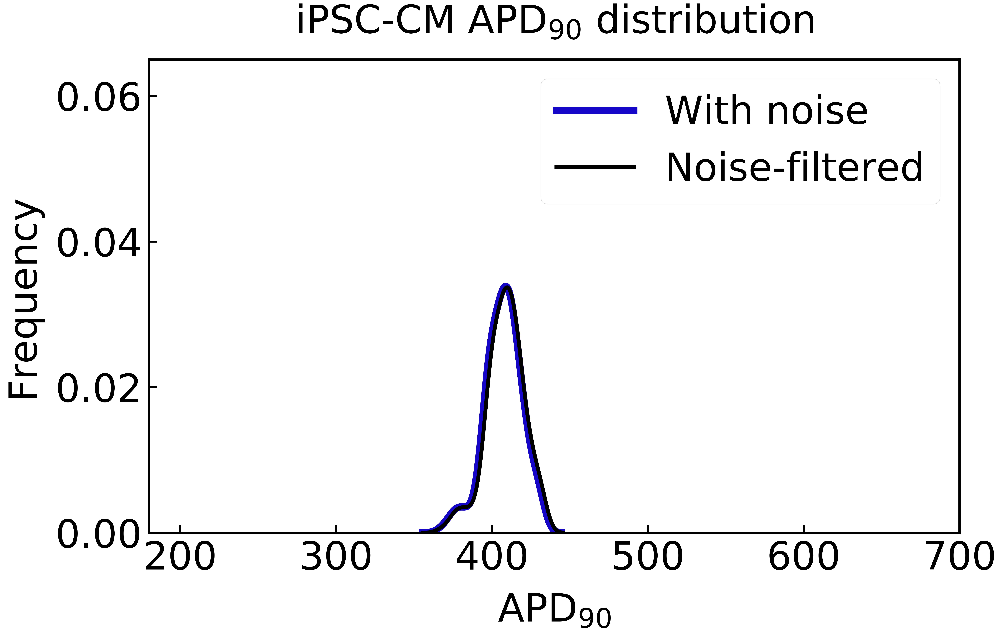

In [43]:
dist_control_iPSC_with_noise = APD90_control_iPSC_with_noise.iloc[:, 0].values
dist_control_iPSC_without_noise = APD90_control_iPSC_without_noise.iloc[:, 0].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.xlim(180, 700) 
plt.ylim(0, 0.065) 
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(200,701, step=100),fontsize=a) 
plt.yticks(np.arange(0,0.061, step=0.02),fontsize=a)

sns.kdeplot(dist_control_iPSC_with_noise,color=[22/256,6/256,201/256],linewidth=15,legend=False)
sns.kdeplot(dist_control_iPSC_without_noise,color=[0,0,0],linewidth=8,legend=False)
custom_lines = [Line2D([0], [0], color=[22/256,6/256,201/256], lw=15),
                Line2D([0], [0], color=[0,0,0], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("APD$_{90}$",fontsize=a, labelpad=30)
plt.ylabel("Frequency",fontsize=a, labelpad=30)
ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': 80})

ttl= plt.title("iPSC-CM APD$_{90}$ distribution",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig12.png', dpi = 300, bbox_inches = 'tight')

## adult control

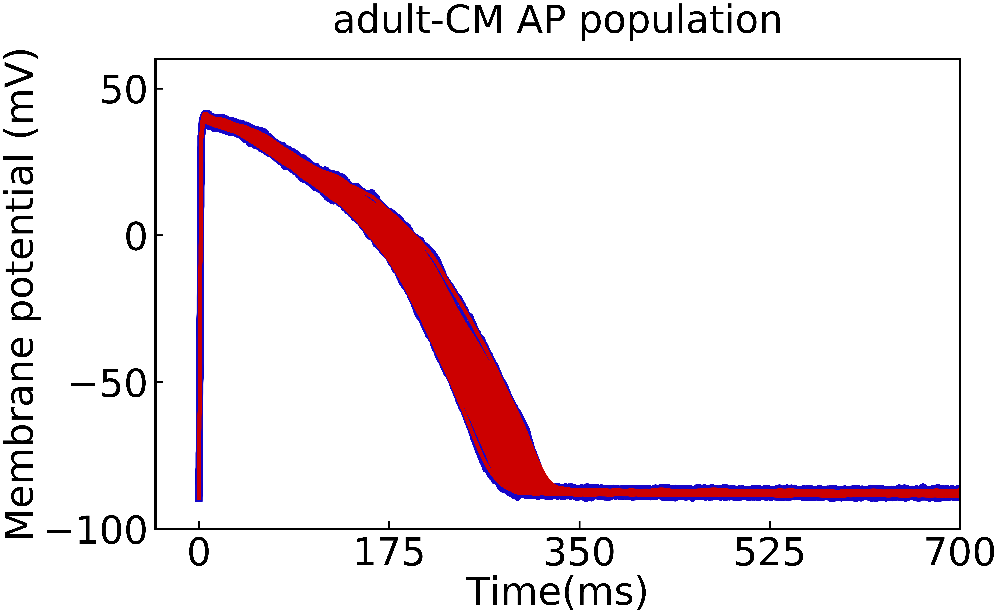

In [44]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)

plt.ylim(-100, 60) 
plt.xlim(-40, 700)   
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
plt.plot(Xplot_control_adult1.transpose(),color=[22/256,6/256,201/256],linewidth=15)
plt.plot(Xplot_control_adult2.transpose(),color=[0.8,0,0],linewidth=8)
custom_lines = [Line2D([0], [0], color=[22/256,6/256,201/256], lw=15),
                Line2D([0], [0], color=[0.8,0,0], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
# ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': 80})

ttl = plt.title("adult-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig21.png', dpi = 300, bbox_inches = 'tight')

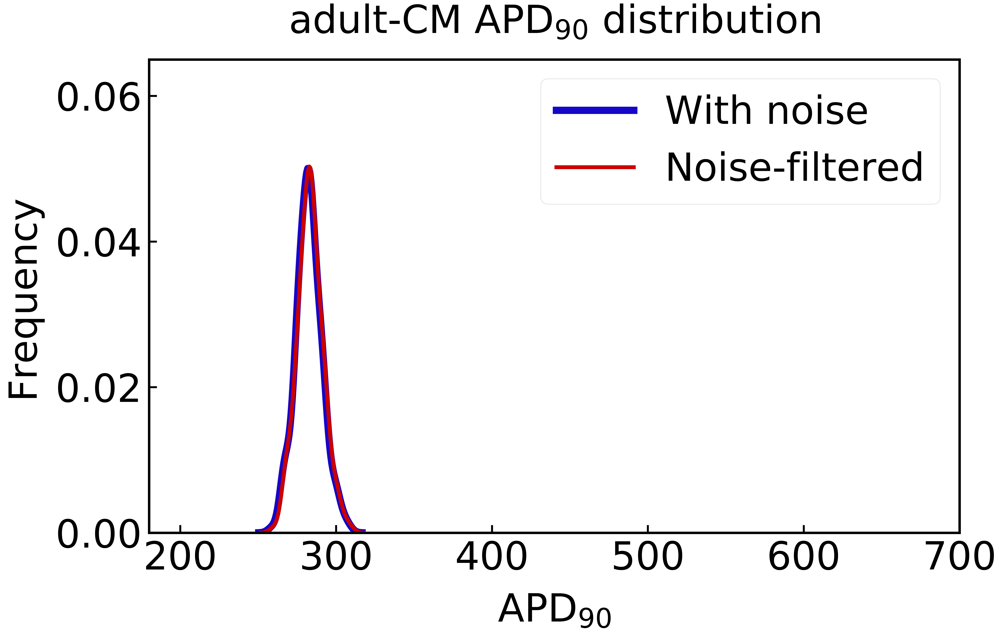

In [45]:
dist_control_adult_with_noise = APD90_control_adult_with_noise.iloc[:, 0].values
dist_control_adult_without_noise = APD90_control_adult_without_noise.iloc[:, 0].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.xlim(180, 700) 
plt.ylim(0, 0.065) 
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(200,701, step=100),fontsize=a) 
plt.yticks(np.arange(0,0.061, step=0.02),fontsize=a)
sns.kdeplot(dist_control_adult_with_noise,color=[22/256,6/256,201/256],linewidth=15,legend=False)
sns.kdeplot(dist_control_adult_without_noise,color=[0.8,0,0],linewidth=8,legend=False)
custom_lines = [Line2D([0], [0], color=[22/256,6/256,201/256], lw=15),
                Line2D([0], [0], color=[0.8,0,0], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("APD$_{90}$",fontsize=a, labelpad=30)
plt.ylabel("Frequency",fontsize=a, labelpad=30)
ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': a})

ttl= plt.title("adult-CM APD$_{90}$ distribution",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig22.png', dpi = 300, bbox_inches = 'tight')

## iPSC block

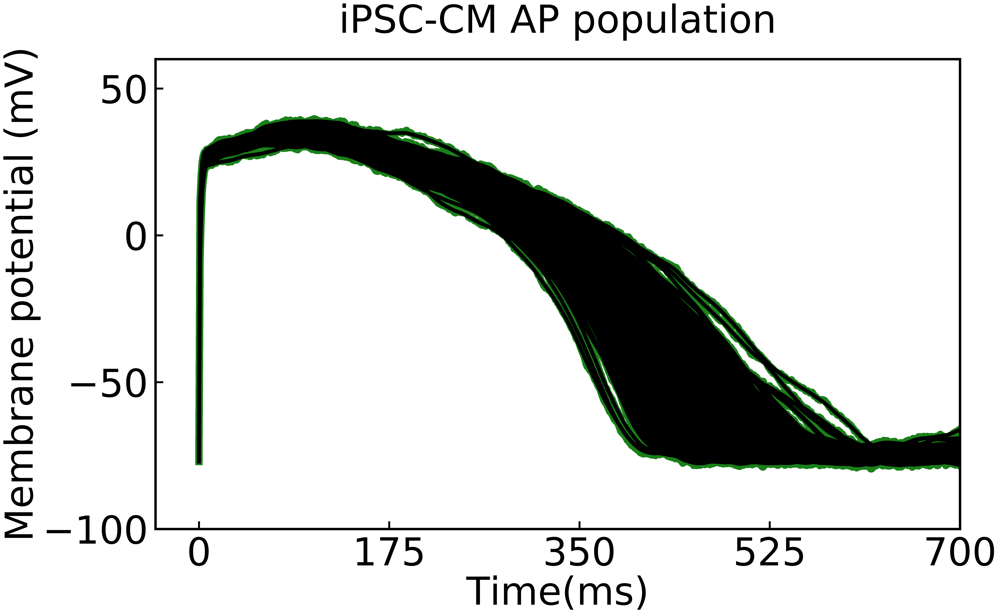

In [46]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)

plt.ylim(-100, 60) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
ax.plot(Xplot_block_ipsc1.transpose(),linewidth=15,color=[0.1,0.5,0.1])
ax.plot(Xplot_block_ipsc2.transpose(),linewidth=8,color=[0,0,0])
# ax.plot(dist_ipsc_nonoise_block.transpose(),linewidth=4,color=[0.9,0.2,0.6])
custom_lines = [Line2D([0], [0], color=[0.1,0.5,0.1], lw=15),
                Line2D([0], [0], color=[0,0,0], lw=8)
#                 Line2D([0], [0], color=[0.9,0.2,0.6], lw=3)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
# ax.legend(custom_lines, ['With noise', 'Noise-filtered','Without noise'],loc = 'upper right', prop={'size': 50})
ttl = plt.title("iPSC-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig31.png', dpi = 300, bbox_inches = 'tight')

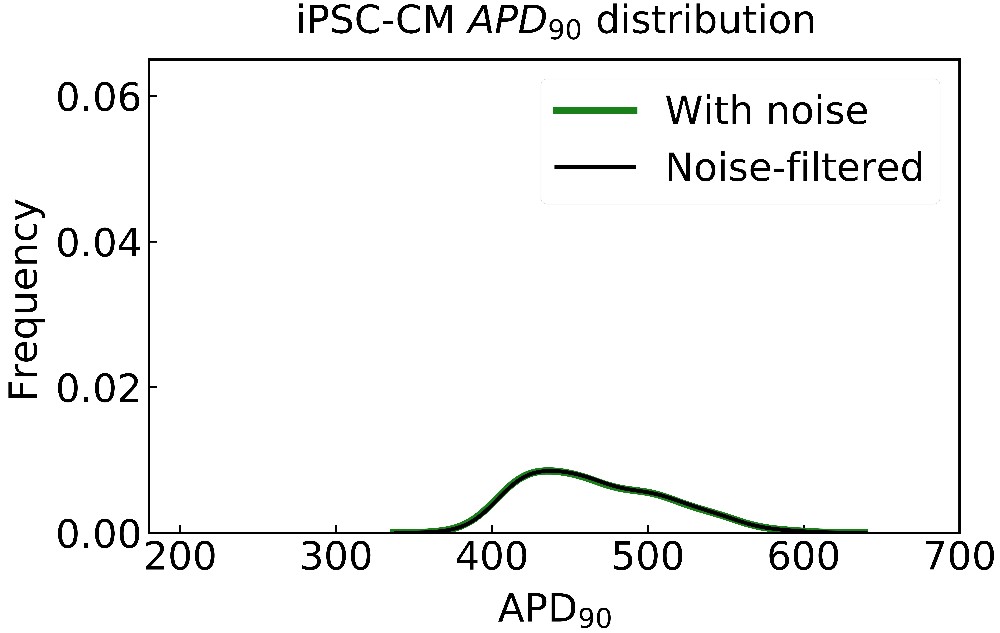

In [47]:
dist_block_ipsc_with_noise = APD90_block_ipsc_with_noise.iloc[:, 0].values
dist_block_ipsc_without_noise = APD90_block_ipsc_without_noise.iloc[:, 0].values
dist_block_ipsc_no_noise = APD90_block_ipsc_no_noise.iloc[:, 0].values

plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.xlim(180, 700) 
plt.ylim(0, 0.065) 
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(200,701, step=100),fontsize=a) 
plt.yticks(np.arange(0,0.061, step=0.02),fontsize=a)

sns.kdeplot(dist_block_ipsc_with_noise,color=[0.1,0.5,0.1],linewidth=15, legend=False)
sns.kdeplot(dist_block_ipsc_without_noise,color=[0,0,0],linewidth=8, legend=False)
# sns.kdeplot(dist_block_ipsc_no_noise,linewidth=8,color=[0.9,0.2,0.6],legend=False)

custom_lines = [Line2D([0], [0], color=[0.1,0.5,0.1], lw=15),
                Line2D([0], [0], color=[0,0,0], lw=8)
#                 Line2D([0], [0], color=[0.9,0.2,0.6], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("APD$_{90}$",fontsize=a, labelpad=30)
plt.ylabel("Frequency",fontsize=a, labelpad=30)
ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': 80})

ttl= plt.title("iPSC-CM $APD_{90}$ distribution",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig32.png', dpi = 300, bbox_inches = 'tight')

## adult block

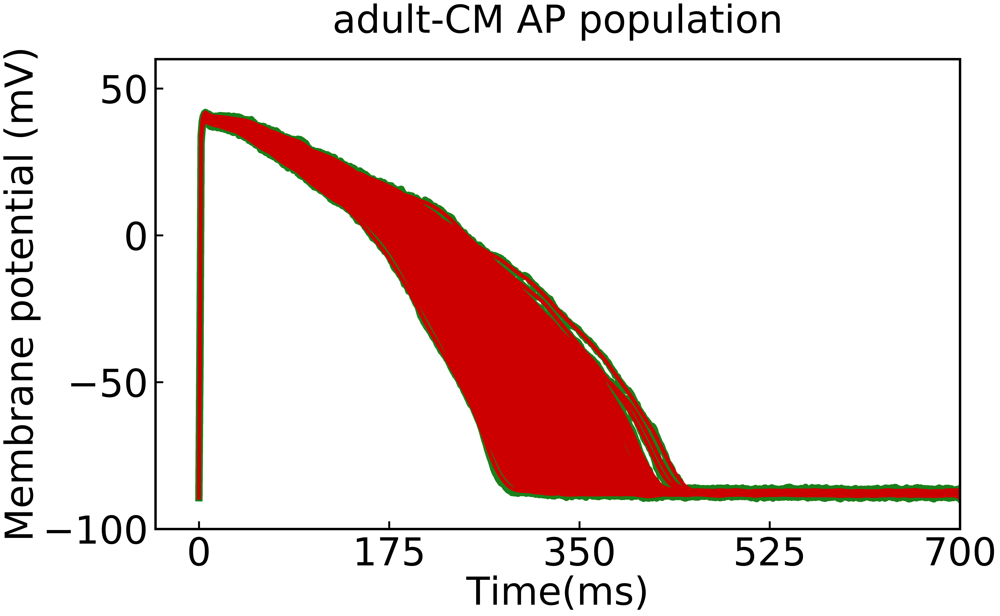

In [48]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.ylim(-100, 60) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
ax.plot(Xplot_block_adult1.transpose(),linewidth=15,color=[0.1,0.5,0.1])
ax.plot(Xplot_block_adult2.transpose(),linewidth=8,color=[0.8,0,0])
# ax.plot(dist_adult_nonoise_block.transpose(),linewidth=3,color=[0.9,0.2,0.6])
custom_lines = [Line2D([0], [0], color=[0.1,0.5,0.1], lw=15),
                Line2D([0], [0], color=[0.8,0,0], lw=8)
#                 Line2D([0], [0], color=[0.9,0.2,0.6], lw=3)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
# ax.legend(custom_lines, ['With noise', 'Noise-filtered','Without noise'],loc = 'upper right', prop={'size': 50})
ttl = plt.title("adult-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig41.png', dpi = 300, bbox_inches = 'tight')

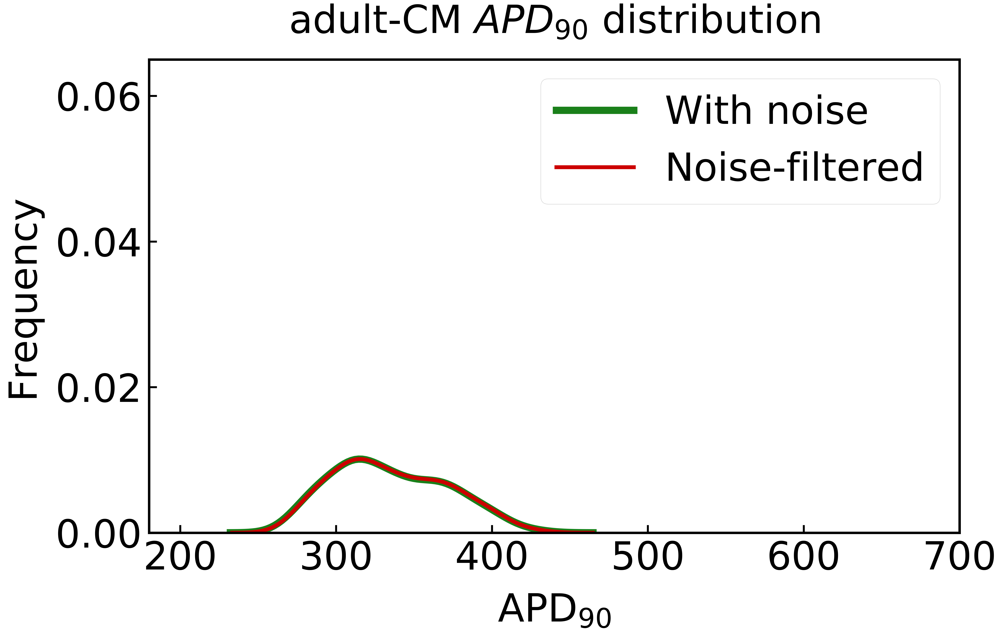

In [49]:
dist_block_adult_with_noise = APD90_block_adult_with_noise.iloc[:, 0].values
dist_block_adult_without_noise = APD90_block_adult_without_noise.iloc[:, 0].values
dist_block_adult_no_noise = APD90_block_adult_no_noise.iloc[:, 0].values

plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.xlim(180, 700) 
plt.ylim(0, 0.065) 
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(200,701, step=100),fontsize=a) 
plt.yticks(np.arange(0,0.061, step=0.02),fontsize=a)

sns.kdeplot(dist_block_adult_with_noise,color=[0.1,0.5,0.1],linewidth=15, legend=False)
sns.kdeplot(dist_block_adult_without_noise,color=[0.8,0,0],linewidth=8, legend=False)
# sns.kdeplot(dist_block_adult_no_noise,linewidth=8,color=[0.9,0.2,0.6],legend=False)
custom_lines = [Line2D([0], [0], color=[0.1,0.5,0.1], lw=15),
                Line2D([0], [0], color=[0.8,0,0], lw=8)
#                 Line2D([0], [0], color=[0.9,0.2,0.6], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("APD$_{90}$",fontsize=a, labelpad=30)
plt.ylabel("Frequency",fontsize=a, labelpad=30)
ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': a})

ttl= plt.title("adult-CM $APD_{90}$ distribution",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig42.png', dpi = 300, bbox_inches = 'tight')

## iPSC dofetilide

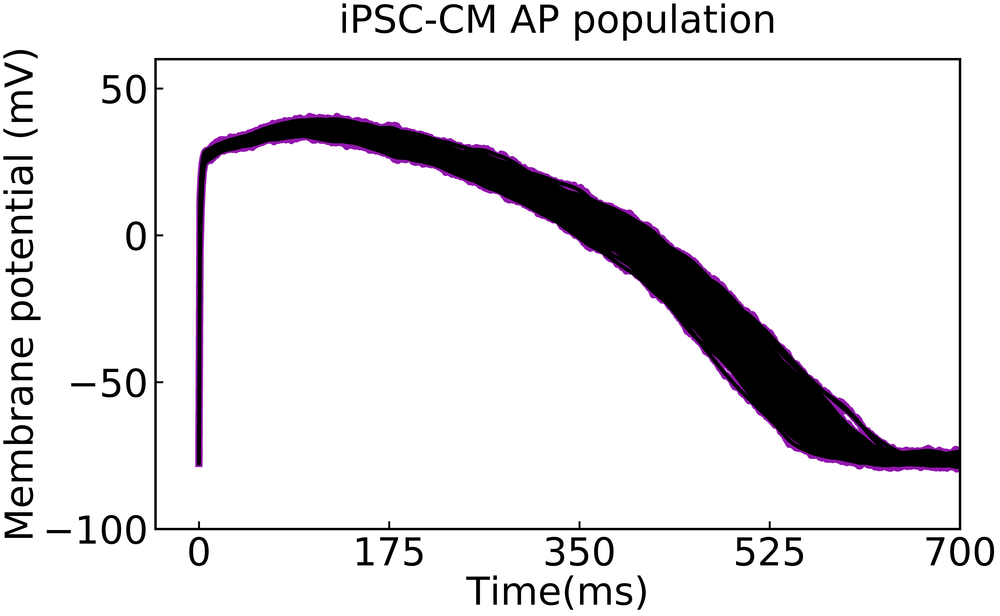

In [62]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)

plt.ylim(-100, 60) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,61, step=50),fontsize=a)
ax.plot(Xplot_dof_ipsc1.transpose(),linewidth=15,color=[146/256,23/256,173/256],label='Noisy traces')
ax.plot(Xplot_dof_ipsc2.transpose(),linewidth=8,color=[0,0,0],label='Noise-filtered traces')
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("iPSC-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig51.png', dpi = 300, bbox_inches = 'tight')

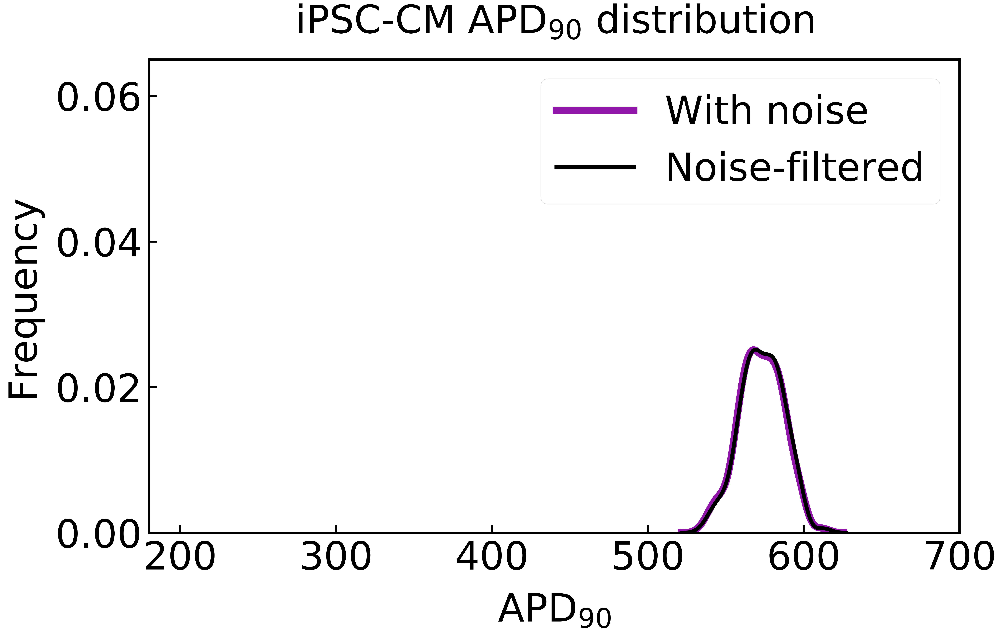

In [51]:
dist_dof_ipsc_with_noise = APD90_dof_ipsc_with_noise.iloc[:, 0].values
dist_dof_ipsc_without_noise = APD90_dof_ipsc_without_noise.iloc[:, 0].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.xlim(180, 700) 
plt.ylim(0, 0.065) 
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(200,701, step=100),fontsize=a) 
plt.yticks(np.arange(0,0.061, step=0.02),fontsize=a)

sns.kdeplot(dist_dof_ipsc_with_noise,color=[146/256,23/256,173/256],linewidth=15,legend=False)
sns.kdeplot(dist_dof_ipsc_without_noise,color=[0,0,0],linewidth=8,legend=False)
custom_lines = [Line2D([0], [0], color=[146/256,23/256,173/256], lw=15),
                Line2D([0], [0], color=[0,0,0], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("APD$_{90}$",fontsize=a,labelpad=30)
plt.ylabel("Frequency",fontsize=a, labelpad=30)
ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': a})

ttl= plt.title("iPSC-CM APD$_{90}$ distribution",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig52.png', dpi = 300, bbox_inches = 'tight')

## adult dofetilide

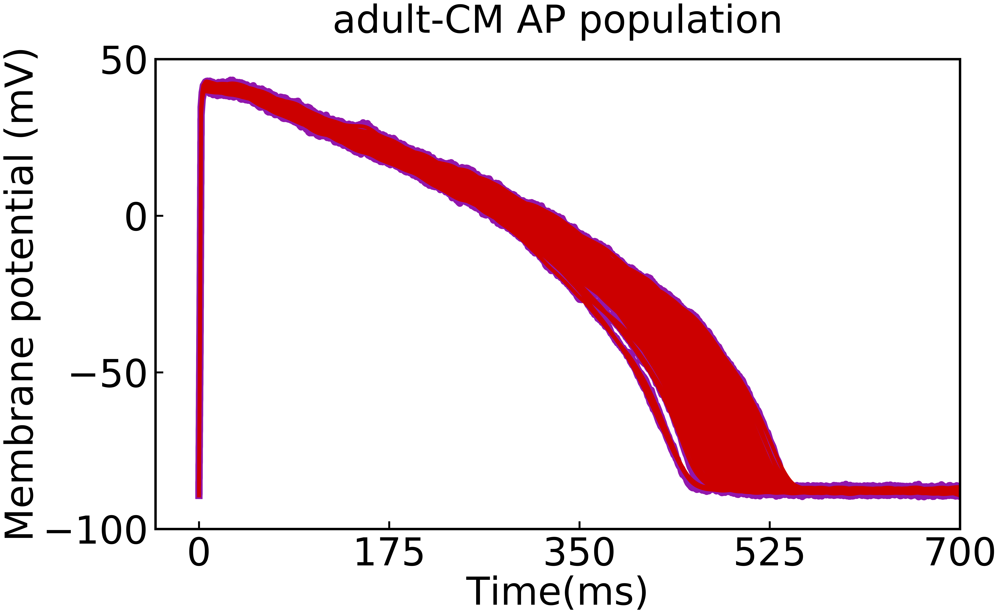

In [52]:
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.ylim(-100, 50,50) 
plt.xlim(-40, 700)  
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(0,701, step=175),fontsize=a) 
plt.yticks(np.arange(-100,51, step=50),fontsize=a)
ax.plot(Xplot_dof_adult1.transpose(),linewidth=15,color=[146/256,23/256,173/256],label='Noisy traces')
ax.plot(Xplot_dof_adult2.transpose(),linewidth=8,color=[0.8,0,0],label='Noise-filtered traces')
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
plt.xlabel("Time(ms)",fontsize=a)
plt.ylabel("Membrane potential (mV)",fontsize=a)
ttl = plt.title("adult-CM AP population",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig61.png', dpi = 300, bbox_inches = 'tight')

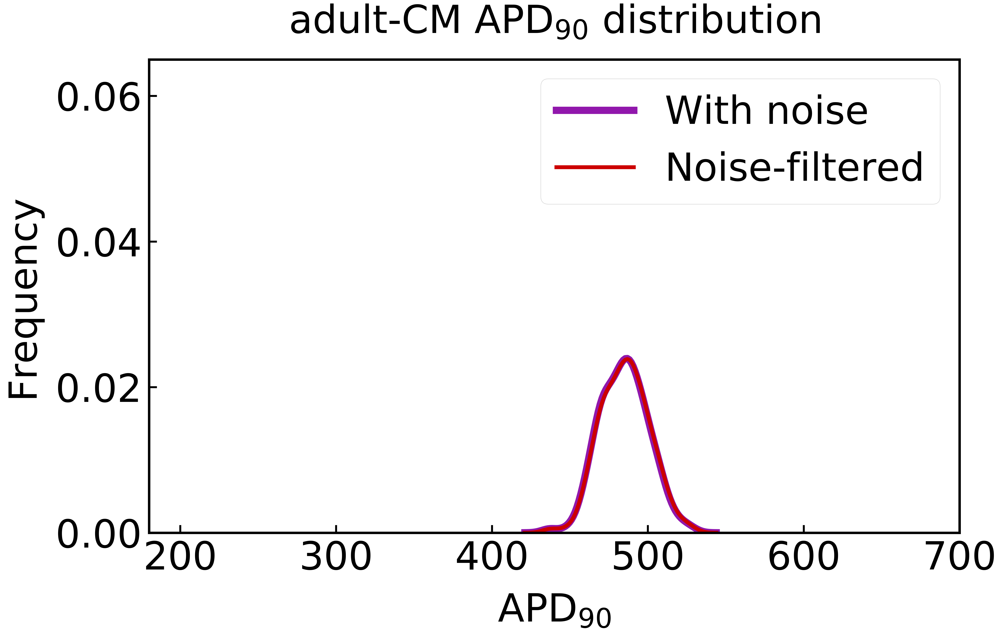

In [53]:
dist_dof_adult_with_noise = APD90_dof_adult_with_noise.iloc[:, 0].values
dist_dof_adult_without_noise = APD90_dof_adult_without_noise.iloc[:, 0].values
plt.figure(num=None, figsize=(30, 18), dpi=300)
plt.rc('axes', linewidth=4)
ax = plt.gca()
ax.tick_params(axis='both', which='major', pad=15)
ax.tick_params(axis="y",direction="in", length=16, width=4)
ax.tick_params(axis="x",direction="in", length=16, width=4)
 
plt.xlim(180, 700) 
plt.ylim(0, 0.065) 
ax.get_xaxis().tick_bottom()  
ax.get_yaxis().tick_left()  
plt.xticks(np.arange(200,701, step=100),fontsize=a) 
plt.yticks(np.arange(0,0.061, step=0.02),fontsize=a)

sns.kdeplot(dist_dof_adult_with_noise,color=[146/256,23/256,173/256],linewidth=15,legend=False)
sns.kdeplot(dist_dof_adult_without_noise,color=[0.8,0,0],linewidth=8,legend=False)
custom_lines = [Line2D([0], [0], color=[146/256,23/256,173/256], lw=15),
                Line2D([0], [0], color=[0.8,0,0], lw=8)
                ]
for axis in ['top','bottom','left','right']:
    ax.spines[axis].set_linewidth(5)
    ax.spines[axis].set_color('black')
    
plt.xlabel("APD$_{90}$",fontsize=a, labelpad=30)
plt.ylabel("Frequency",fontsize=a, labelpad=30)
ax.legend(custom_lines, ['With noise', 'Noise-filtered'],loc = 'upper right', prop={'size': a})

ttl= plt.title("adult-CM APD$_{90}$ distribution",fontsize=a)
ttl.set_position([.5, 1.05])
plt.savefig(path_save+'Fig2/Fig62.png', dpi = 300, bbox_inches = 'tight')

# save data

## with noise

In [54]:
ipsc_control_with_noise = pd.DataFrame(Xplot_control_ipsc1)
adult_control_with_noise = pd.DataFrame(Xplot_control_adult1)
ipsc_block_with_noise = pd.DataFrame(Xplot_block_ipsc1)
adult_block_with_noise = pd.DataFrame(Xplot_block_adult1)
ipsc_dof_with_noise= pd.DataFrame(Xplot_dof_ipsc1)
adult_dof_with_noise = pd.DataFrame(Xplot_dof_adult1)

In [55]:
input_with_noise=ipsc_control_with_noise.append([ipsc_block_with_noise,ipsc_dof_with_noise], ignore_index=True, sort=False)
target_with_noise=adult_control_with_noise.append([adult_block_with_noise,adult_dof_with_noise], ignore_index=True, sort=False)


## without noise

In [56]:
ipsc_control_without_noise = pd.DataFrame(Xplot_control_ipsc2)
adult_control_without_noise = pd.DataFrame(Xplot_control_adult2)
ipsc_block_without_noise = pd.DataFrame(Xplot_block_ipsc2)
adult_block_without_noise = pd.DataFrame(Xplot_block_adult2)
ipsc_dof_without_noise= pd.DataFrame(Xplot_dof_ipsc2)
adult_dof_without_noise = pd.DataFrame(Xplot_dof_adult2)

In [57]:
ipsc_block_without_noise.shape

(250, 701)

In [58]:
ipsc_dof_without_noise.shape

(301, 701)

In [59]:
input_without_noise=ipsc_control_without_noise.append([ipsc_block_without_noise,ipsc_dof_without_noise], ignore_index=True, sort=False)
target_without_noise=adult_control_without_noise.append([adult_block_without_noise,adult_dof_without_noise], ignore_index=True, sort=False)

## save into CSV file

In [60]:
# input_with_noise.to_csv(path_read + 'clean_data/input_with_noise.csv',mode = 'w',header= False, index=False)
# target_with_noise.to_csv(path_read + 'clean_data/target_with_noise.csv',mode = 'w',header= False, index=False)
# input_without_noise.to_csv(path_read + 'clean_data/input_without_noise.csv',mode = 'w',header= False, index=False)
# target_without_noise.to_csv(path_read + 'clean_data/target_without_noise.csv',mode = 'w',header= False, index=False)

In [61]:
# ipsc_control_with_noise.to_csv(path_read + 'clean_data/ipsc_control_with_noise.csv',mode = 'w',header= False, index=False)
# adult_control_with_noise.to_csv(path_read + 'clean_data/adult_control_with_noise.csv',mode = 'w',header= False, index=False)
# ipsc_block_with_noise.to_csv(path_read + 'clean_data/ipsc_block_with_noise.csv',mode = 'w',header= False, index=False)
# adult_block_with_noise.to_csv(path_read + 'clean_data/adult_block_with_noise.csv',mode = 'w',header= False, index=False)
# ipsc_dof_with_noise.to_csv(path_read + 'clean_data/ipsc_dof_with_noise.csv',mode = 'w',header= False, index=False)
# adult_dof_with_noise.to_csv(path_read + 'clean_data/adult_dof_with_noise.csv',mode = 'w',header= False, index=False)
# ipsc_control_without_noise.to_csv(path_read + 'clean_data/ipsc_control_without_noise.csv',mode = 'w',header= False, index=False)
# adult_control_without_noise.to_csv(path_read + 'clean_data/adult_control_without_noise.csv',mode = 'w',header= False, index=False)
# ipsc_block_without_noise.to_csv(path_read + 'clean_data/ipsc_block_without_noise.csv',mode = 'w',header= False, index=False)
# adult_block_without_noise.to_csv(path_read + 'clean_data/adult_block_without_noise.csv',mode = 'w',header= False, index=False)
# ipsc_dof_without_noise.to_csv(path_read + 'clean_data/ipsc_dof_without_noise.csv',mode = 'w',header= False, index=False)
# adult_dof_without_noise.to_csv(path_read + 'clean_data/adult_dof_without_noise.csv',mode = 'w',header= False, index=False)